In [1]:
import numpy as np
import matplotlib.pyplot as plt
from astropy.io import fits
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from tqdm import tqdm

import PLred.mapmodel as mm

In [2]:
couplingmap_data = 'betcmi_20250510_apapane_couplingmap_thres6000.fits'

In [4]:
data = fits.open(couplingmap_data)

frames0 = data[0].data
header = data[0].header
numframes = data[1].data
var = data[3].data
normvar = data[4].data

pos_mas = np.linspace(header['XMIN'], header['XMAX'], header['MAP_N'])
normalized = frames0 / np.nansum(frames0, axis=(0,1))[None,None,:,:]

n = len(pos_mas)

/var/folders/3q/t9m8zt610pjc_x572xlprc000000gn/T/ipykernel_62067/1557384042.py:10: RuntimeWarning: invalid value encountered in divide
  normalized = frames0 / np.nansum(frames0, axis=(0,1))[None,None,:,:]


Text(0, 0.5, 'y (mas)')

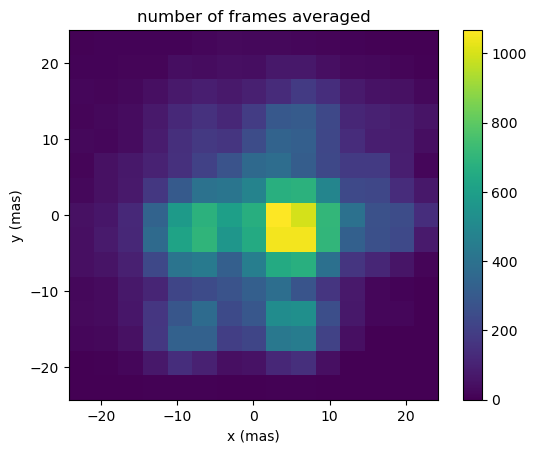

In [5]:
plt.imshow(numframes, extent = (pos_mas[0], pos_mas[-1],
                                pos_mas[0], pos_mas[-1]), origin='upper')
plt.colorbar()
plt.title('number of frames averaged')
plt.xlabel('x (mas)')
plt.ylabel('y (mas)')

In [6]:
mapmodel = mm.CouplingMapModel(mapdata = couplingmap_data)


loading mapdata
masking data with less than 5 frames


/Users/yjkim/Documents/PLred/PLred/mapmodel.py:404: RuntimeWarning: invalid value encountered in divide
  self.normdata = self.data / np.nansum(self.data, axis=(0,1))[None,None]


In [8]:
np.shape(mapmodel.data)

(15, 15, 3, 512)

(400000.0, 600000.0)

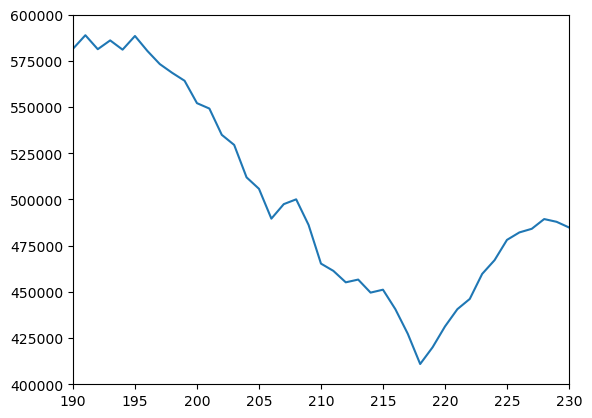

In [21]:
plt.plot(np.nansum(mapmodel.data,axis=(0,1,2)))
plt.xlim([190,230])
plt.ylim([4e5,6e5])

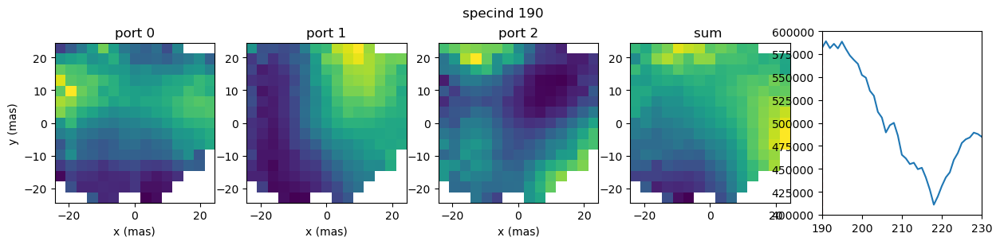

In [24]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML


fig, axs = plt.subplots(ncols=5, nrows=1, figsize=(15,3))

def animate(specind):
    for ax in axs: ax.clear()
    for i in range(3):
        axs[i].imshow(mapmodel.data[:,:,i,specind], extent = (pos_mas[0], pos_mas[-1],
                                                pos_mas[0], pos_mas[-1]), origin='upper')
        axs[i].set_title(f'port {i}')
        axs[i].set_xlabel('x (mas)')

    axs[3].imshow(np.sum(mapmodel.data[:,:,:,specind], axis=2), extent = (pos_mas[0], pos_mas[-1],
                                                pos_mas[0], pos_mas[-1]), origin='upper')
    axs[3].set_title('sum ')
    axs[0].set_ylabel('y (mas)')
    fig.suptitle(f'specind {specind}')

    axs[4].plot(np.nansum(mapmodel.data,axis=(0,1,2)))
    axs[4].set_xlim([190,230])
    axs[4].set_ylim([4e5,6e5])
    axs[4].axvline(specind, color='red', linestyle='--')

anim = FuncAnimation(fig, animate, frames=np.arange(190,230), interval=100)
HTML(anim.to_jshtml())

In [25]:
anim.save('3PL_couplingmap_betcmi_20250510.gif')

MovieWriter ffmpeg unavailable; using Pillow instead.


Animation size has reached 21003391 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


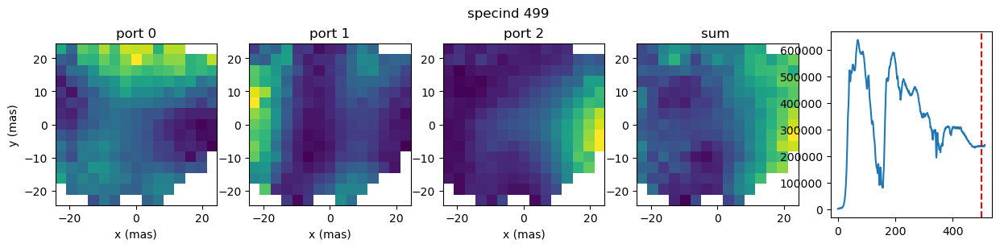

In [27]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML


fig, axs = plt.subplots(ncols=5, nrows=1, figsize=(15,3))

def animate(specind):
    for ax in axs: ax.clear()
    for i in range(3):
        axs[i].imshow(mapmodel.data[:,:,i,specind], extent = (pos_mas[0], pos_mas[-1],
                                                pos_mas[0], pos_mas[-1]), origin='upper')
        axs[i].set_title(f'port {i}')
        axs[i].set_xlabel('x (mas)')

    axs[3].imshow(np.sum(mapmodel.data[:,:,:,specind], axis=2), extent = (pos_mas[0], pos_mas[-1],
                                                pos_mas[0], pos_mas[-1]), origin='upper')
    axs[3].set_title('sum ')
    axs[0].set_ylabel('y (mas)')
    fig.suptitle(f'specind {specind}')

    axs[4].plot(np.nansum(mapmodel.data,axis=(0,1,2)))
    # axs[4].set_xlim([190,230])
    # axs[4].set_ylim([4e5,6e5])
    axs[4].axvline(specind, color='red', linestyle='--')

anim = FuncAnimation(fig, animate, frames=np.arange(100,500), interval=100)
HTML(anim.to_jshtml())